In [55]:
import pandas as pd
import pickle

import sys
sys.path.append('../')

import community_detection

import warnings
warnings.filterwarnings(action='ignore') 


def save_pkl(data, path):
    with open(path, 'wb') as ww:
        pickle.dump(data, ww)
        
def load_pkl(path):
    with open(path, 'rb') as rr:
        data = pickle.load(rr)
    return data

## Load Data

In [56]:
london_raw = load_pkl('../../data/london.pkl')
station_info = pd.read_csv('../../data/london_stations.csv')

## 공통 전처리

In [57]:
london = london_raw.dropna(axis=0)

In [58]:
print("raw   data :", len(london_raw))
print("na rm data :", len(london))

raw   data : 38215560
na rm data : 38147278


In [59]:
station_list = set(london['start_station_name'].unique()) & set(station_info['station_name'].unique()) & set(london['end_station_name'].unique())

In [60]:
print(len(list(station_info['station_name'])), len(list(station_list)))

802 758


In [61]:
station_tbr = [item for item in station_info['station_name'] if item not in list(station_list)]

## Case에 맞게 전처리

### Case 2: 대여 요일 별 분석 - 평일/주말

In [62]:
import datetime

In [63]:
week_values = pd.to_datetime(london.start_rental_date_time.values, format = "%Y-%m-%d %H:%M:%S")
week_values = [date.weekday() for date in week_values]
london.loc[:, 'weekday'] = week_values

In [64]:
london_weekday = london.query("weekday < 5")
london_weekend = london.query("weekday >= 5")

In [65]:
london_weekday = london_weekday.drop('weekday', axis = 1)
london_weekend = london_weekend.drop('weekday', axis = 1)

### COVID-19 전후 data 분할

In [66]:
def covid_divide(data):
    data_entire = data
    data_before = data.query("start_rental_date_time >= '2019-01-01' and start_rental_date_time < '2019-09-01'")
    data_after = data.query("start_rental_date_time >= '2020-01-01' and start_rental_date_time < '2020-09-01'")


    # 전체/전/후
    data_entire['end_station_id'] = data_entire['end_station_id'].astype('float')
    data_before['end_station_id'] = data_before['end_station_id'].astype('float')
    data_after['end_station_id'] = data_after['end_station_id'].astype('float')

    return data_entire, data_before, data_after

In [67]:
weekday_entire, weekday_before, weekday_after = covid_divide(london_weekday)

## Co_occurence matrix 

In [68]:
def make_co_matrix(entire, before, after):
    co_matrix_en = pd.crosstab(entire['start_station_id'], entire['end_station_id'])
    co_matrix_bf = pd.crosstab(before['start_station_id'], before['end_station_id'])
    co_matrix_af = pd.crosstab(after['start_station_id'], after['end_station_id'])
    return co_matrix_en, co_matrix_bf, co_matrix_af

In [69]:
def get_station_ids(geost, label_index):
    
    '''args : geost, label_index'''
    
    station_ids = list(set(geost[geost['label']==label_index]['station_id']))
    
    print(f"we get {len(station_ids)} station ids which in {label_index} label index area.")
    
    return station_ids


def get_area_df(dataframe, station_ids):
    
    '''args : dataframe, station_ids'''
    
    indices_tmp = []

    for i in range(len(station_ids)):
        index_tmp = list(dataframe[dataframe['start_station_id']==station_ids[i]]['start_station_id'])
        indices_tmp.append(index_tmp)
    
    indices_area = set()

    for i in range(len(indices_tmp)):
        for j in indices_tmp[i]:
            indices_area.add(j)
                   
                
    df_area = dataframe[dataframe['start_station_id'].isin(indices_area)]
                   
    df_area.reset_index(inplace=True, drop=True)
                   
    return df_area


### 지역 11

In [70]:
geost = load_pkl('../../data/geostations.pkl')

In [71]:
london = load_pkl('../../data/london_preprocessed.pkl')
station_ids = get_station_ids(geost, 11)
london = get_area_df(london, station_ids)

week_values = pd.to_datetime(london.start_rental_date_time.values, format = "%Y-%m-%d %H:%M:%S")
week_values = [date.weekday() for date in week_values]
london.loc[:, 'weekday'] = week_values

london_weekday = london.query("weekday < 5")
london_weekend = london.query("weekday >= 5")

london_weekday = london_weekday.drop('weekday', axis = 1)
london_weekend = london_weekend.drop('weekday', axis = 1)

weekday_entire, weekday_before, weekday_after = covid_divide(london_weekday)
weekend_entire, weekend_before, weekend_after = covid_divide(london_weekend)

co_matrix_en_day, co_matrix_bf_day, co_matrix_af_day = make_co_matrix(weekday_entire, weekday_before, weekday_after)
co_matrix_en_end, co_matrix_bf_end, co_matrix_af_end = make_co_matrix(weekend_entire, weekend_before, weekend_after)

we get 60 station ids which in 11 label index area.


In [72]:
import os; 

case = 2
area = 11
case_path = f'../../result/case-{case}/area-{area}'

try: 
    os.mkdir(case_path)
except: 
    print('already exits')

co_matrix_en_day.to_csv(case_path+"/co_matrix_en_day.csv")
co_matrix_bf_day.to_csv(case_path+"/co_matrix_bf_day.csv")
co_matrix_af_day.to_csv(case_path+"/co_matrix_af_day.csv")

co_matrix_en_end.to_csv(case_path+"/co_matrix_en_end.csv")
co_matrix_bf_end.to_csv(case_path+"/co_matrix_bf_end.csv")
co_matrix_af_end.to_csv(case_path+"/co_matrix_af_end.csv")

already exits


In [73]:
path_list = ["/co_matrix_en_day.csv","/co_matrix_bf_day.csv","/co_matrix_af_day.csv","/co_matrix_en_end.csv", "/co_matrix_bf_end.csv","/co_matrix_af_end.csv"]

In [74]:
if not os.path.exists(case_path+'/node_and_edge_list'):
    os.makedirs(case_path+'/node_and_edge_list')
if not os.path.exists(case_path+'/node_per_class'):
    os.makedirs(case_path+'/node_per_class')

=============/co_matrix_en_day.csv=============
Object for COMMUNITY DETECTION


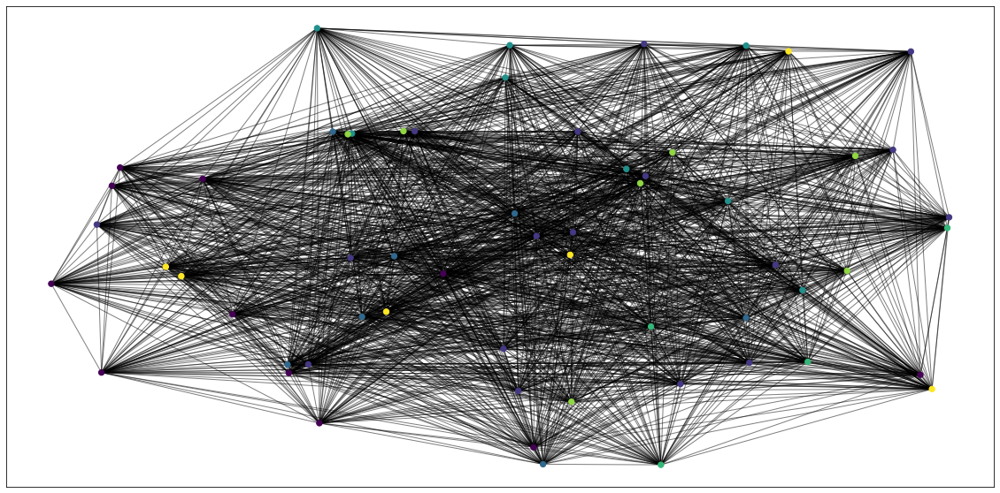

{0: [62, 270, 352, 374, 676, 827, 829, 830, 831, 832, 833], 1: [74, 86, 91, 139, 154, 173, 284, 305, 334, 336, 347, 355, 361, 435, 440, 600, 808], 2: [100, 197, 272, 624, 802, 814, 819], 3: [117, 252, 371, 387, 412, 437, 612, 772], 4: [144, 602, 654, 669], 5: [149, 377, 630, 677, 794, 813, 815], 6: [273, 310, 441, 603, 641, 828], 7: []}
=============/co_matrix_bf_day.csv=============
Object for COMMUNITY DETECTION


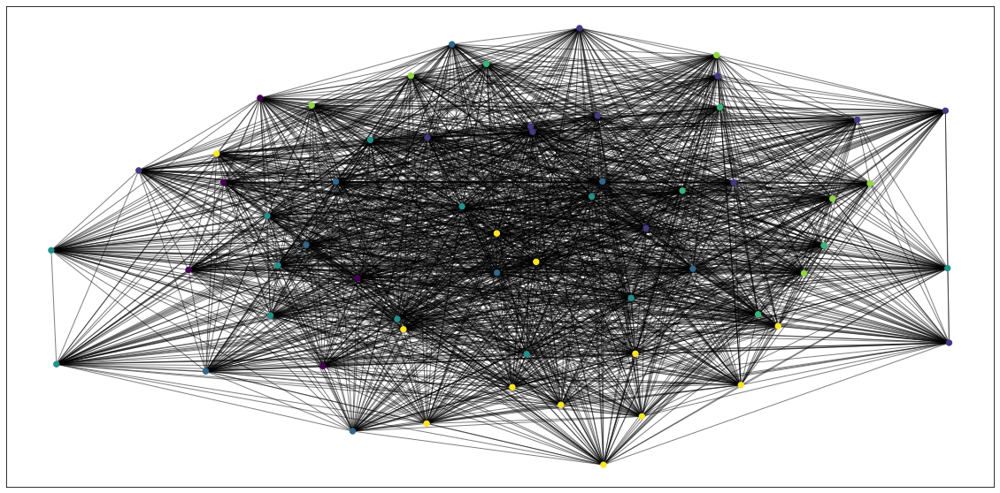

{0: [62, 270, 676, 829, 833], 1: [117, 149, 252, 371, 387, 412, 441, 624, 630, 772, 802, 813], 2: [91, 305, 352, 374, 377, 437, 794, 831], 3: [74, 86, 100, 173, 197, 284, 334, 347, 355, 361, 440, 603], 4: [272, 808, 814, 815, 819], 5: [139, 336, 435, 600, 602, 612], 6: [144, 154, 273, 310, 641, 654, 669, 677, 827, 828, 830, 832], 7: []}
=============/co_matrix_af_day.csv=============
Object for COMMUNITY DETECTION


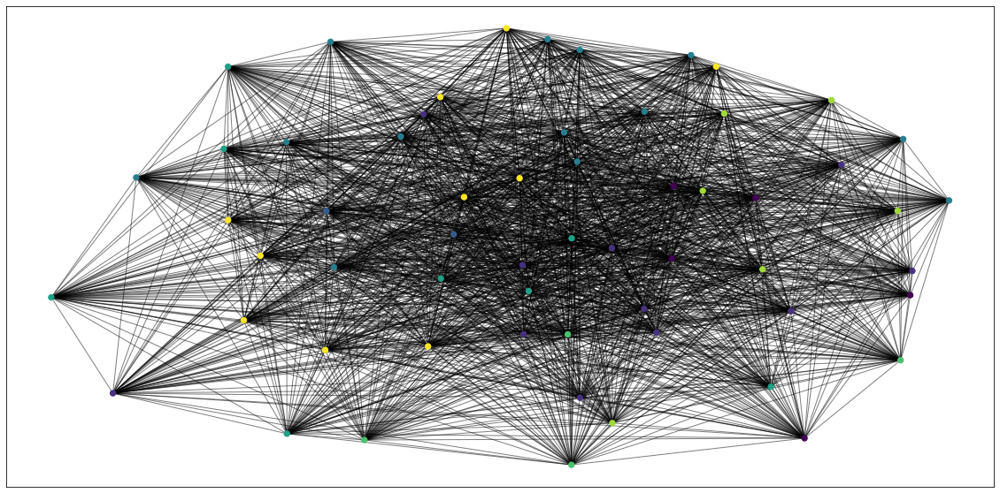

{0: [62, 149, 270, 641, 772], 1: [74, 86, 117, 197, 310, 347, 412, 440, 802, 808, 815], 2: [91, 154], 3: [100, 272, 334, 654, 677, 814, 819, 827, 828, 829, 831, 832, 833], 4: [173, 284, 352, 361, 371, 374, 441, 630], 5: [139, 252, 437, 602], 6: [144, 355, 603, 612, 669, 676], 7: [273, 336, 377, 387, 435, 600, 624, 794, 813, 830]}
=============/co_matrix_en_end.csv=============
Object for COMMUNITY DETECTION


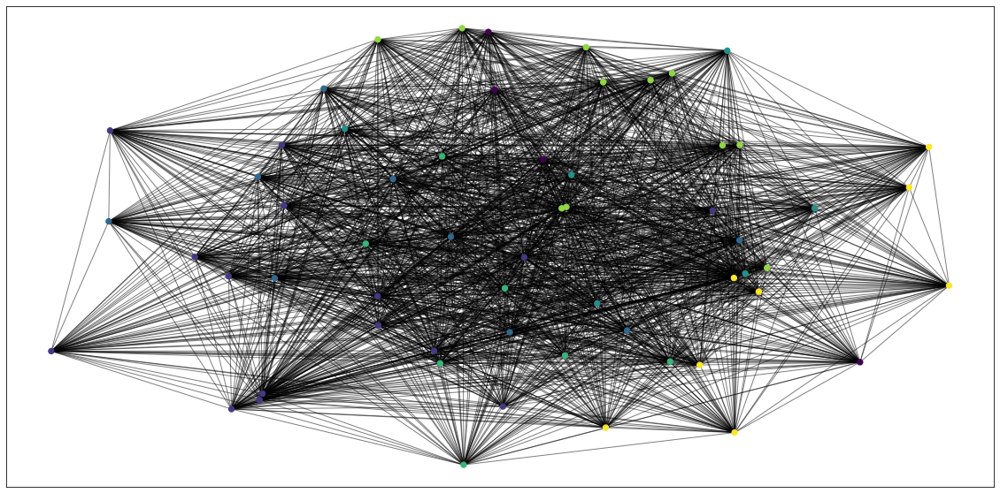

{0: [62, 270, 676, 833], 1: [74, 86, 139, 173, 197, 284, 347, 355, 377, 435, 440, 600, 630, 815, 829], 2: [91, 154, 305, 334, 352, 361, 374, 437, 808], 3: [100, 272, 624, 802, 814, 819], 4: [117, 252, 336, 387, 412, 612, 794], 5: [149, 273, 310, 603, 677, 813, 827, 828, 830, 831, 832], 6: [144, 371, 441, 602, 641, 654, 669, 772], 7: []}
=============/co_matrix_bf_end.csv=============
Object for COMMUNITY DETECTION


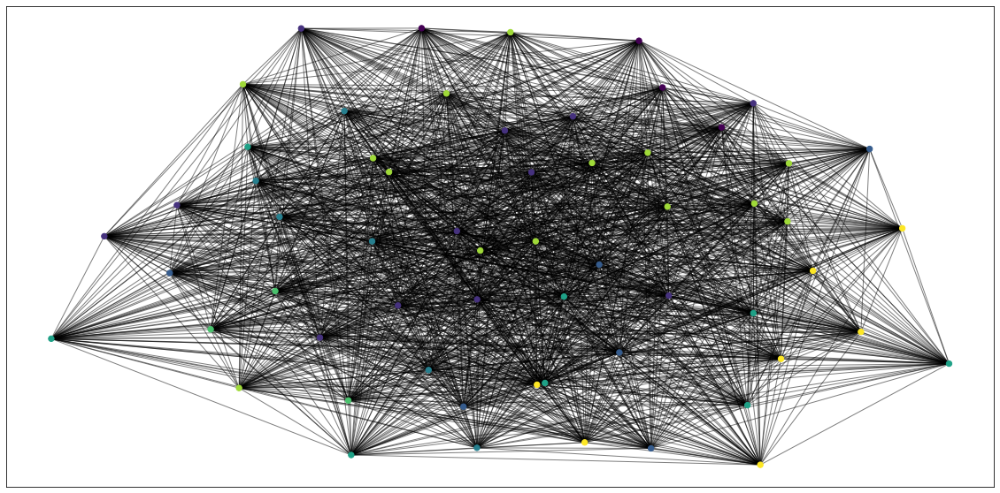

{0: [62, 305, 437, 808], 1: [74, 86, 154, 197, 284, 334, 347, 355, 361, 435, 440, 600], 2: [91, 144, 336, 602, 654, 669], 3: [100, 272, 624, 802, 814, 819], 4: [117, 139, 173, 252, 387, 412, 612, 794], 5: [270, 676, 833], 6: [149, 273, 310, 352, 374, 603, 677, 813, 827, 828, 829, 830, 831, 832], 7: [371, 377, 441, 630, 641, 772, 815]}
=============/co_matrix_af_end.csv=============
Object for COMMUNITY DETECTION


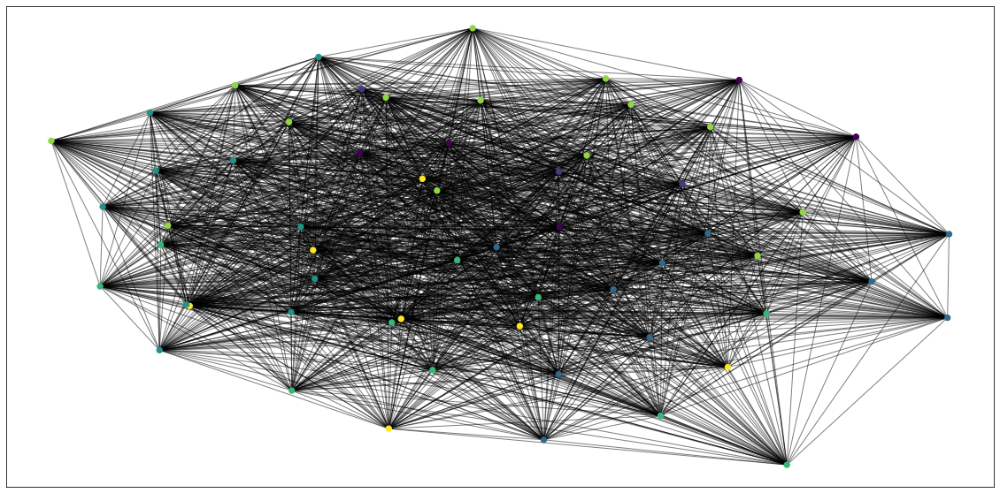

{0: [62, 149, 270, 641, 772], 1: [144, 603, 669], 2: [91, 154, 252, 336, 352, 355, 371, 377, 435, 437], 3: [100, 272, 630, 677, 813, 814, 819, 827, 828, 832], 4: [74, 86, 117, 173, 347, 412, 440, 602, 802, 808], 5: [139, 273, 334, 387, 600, 612, 624, 654, 676, 794, 829, 830, 831, 833], 6: [197, 284, 310, 361, 374, 441, 815], 7: []}


In [75]:
for path in path_list:
    print(f'============={path}=============')
    detector = community_detection.community_detection()
    save_path = case_path+path
    G, node_and_edge_list = detector.fit(save_path)
    detector.make_plot(G, save_path)
    node_per_class = detector.node_per_class()
    save_pkl(node_and_edge_list, case_path+'/node_and_edge_list/'+path[-10:-4]+ '.pkl')
    save_pkl(node_per_class, case_path+'/node_per_class/'+path[-10:-4]+ '.pkl')

In [76]:
### 지역 25

In [77]:
london = load_pkl('../../data/london_preprocessed.pkl')
station_ids = get_station_ids(geost, 25)
london = get_area_df(london, station_ids)

week_values = pd.to_datetime(london.start_rental_date_time.values, format = "%Y-%m-%d %H:%M:%S")
week_values = [date.weekday() for date in week_values]
london.loc[:, 'weekday'] = week_values

london_weekday = london.query("weekday < 5")
london_weekend = london.query("weekday >= 5")

london_weekday = london_weekday.drop('weekday', axis = 1)
london_weekend = london_weekend.drop('weekday', axis = 1)

weekday_entire, weekday_before, weekday_after = covid_divide(london_weekday)
weekend_entire, weekend_before, weekend_after = covid_divide(london_weekend)

co_matrix_en_day, co_matrix_bf_day, co_matrix_af_day = make_co_matrix(weekday_entire, weekday_before, weekday_after)
co_matrix_en_end, co_matrix_bf_end, co_matrix_af_end = make_co_matrix(weekend_entire, weekend_before, weekend_after)

we get 172 station ids which in 25 label index area.


In [78]:
import os; 

case = 2
area = 25
case_path = f'../../result/case-{case}/area-{area}'

try: 
    os.mkdir(case_path)
except: 
    print('already exits')

co_matrix_en_day.to_csv(case_path+"/co_matrix_en_day.csv")
co_matrix_bf_day.to_csv(case_path+"/co_matrix_bf_day.csv")
co_matrix_af_day.to_csv(case_path+"/co_matrix_af_day.csv")

co_matrix_en_end.to_csv(case_path+"/co_matrix_en_end.csv")
co_matrix_bf_end.to_csv(case_path+"/co_matrix_bf_end.csv")
co_matrix_af_end.to_csv(case_path+"/co_matrix_af_end.csv")

already exits


In [79]:
if not os.path.exists(case_path+'/node_and_edge_list'):
    os.makedirs(case_path+'/node_and_edge_list')
if not os.path.exists(case_path+'/node_per_class'):
    os.makedirs(case_path+'/node_per_class')

=============/co_matrix_en_day.csv=============
Object for COMMUNITY DETECTION


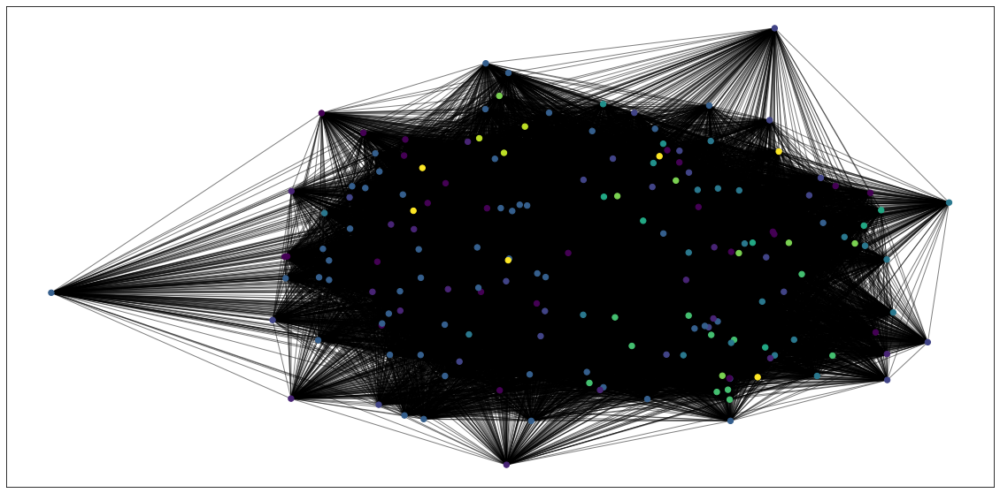

{0: [47, 56, 60, 82, 109, 111, 118, 141, 164, 169, 176, 229, 259, 279, 289, 290, 299, 312, 335, 370, 373, 392, 408, 426, 558], 1: [147, 188, 248, 271, 283, 303, 329, 341, 349, 354, 359, 360, 366, 376, 410], 2: [29, 64, 81, 83, 110, 129, 167, 185, 221, 281, 291, 292, 309, 315, 318, 330, 348, 350, 403, 419, 514, 541, 583, 760], 3: [6, 7, 8, 28, 43, 44, 45, 49, 53, 105, 108, 121, 124, 138, 146, 148, 153, 160, 165, 177, 178, 181, 182, 184, 186, 191, 201, 207, 208, 210, 213, 222, 224, 226, 228, 242, 247, 256, 257, 267, 294, 338, 363, 380, 386, 389, 394, 396, 524, 564, 799, 809], 4: [106, 116, 159, 174, 180, 192, 258, 260, 288, 301, 353, 367, 383, 400, 428, 581, 590, 605, 733, 762], 5: [114, 528, 646], 6: [232, 388, 423, 594, 759, 826], 7: [161, 233, 238, 243, 245, 255, 261, 268, 300, 313, 316]}
=============/co_matrix_bf_day.csv=============
Object for COMMUNITY DETECTION


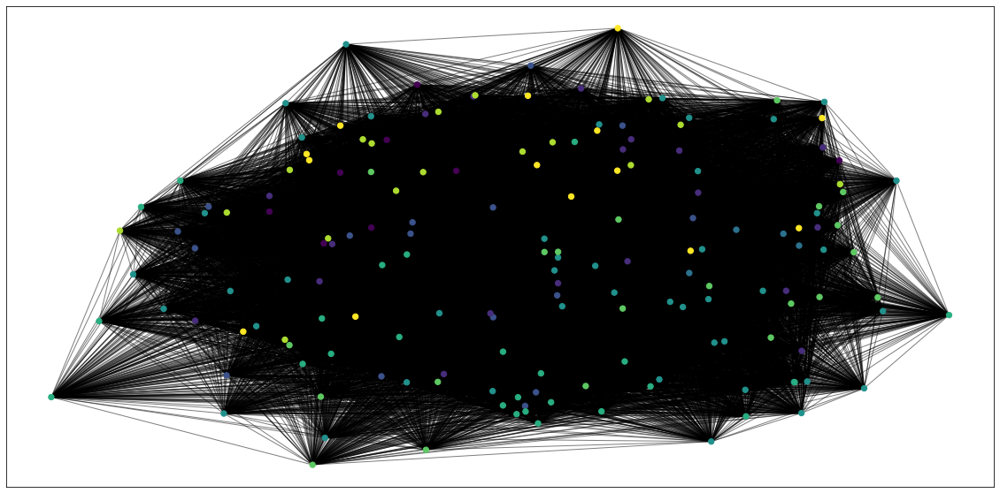

{0: [114, 228, 233, 315, 338, 350, 397, 583], 1: [6, 109, 118, 129, 138, 161, 165, 221, 242, 243, 261, 267, 279, 290, 291, 301, 363, 366, 410], 2: [116, 169, 181, 188, 190, 191, 213, 222, 268, 312, 349, 392, 396, 423, 584, 826], 3: [320, 354, 528, 818], 4: [7, 8, 29, 43, 45, 47, 53, 60, 81, 82, 105, 106, 108, 111, 141, 146, 148, 159, 160, 174, 177, 178, 180, 184, 185, 192, 201, 207, 210, 247, 271, 300, 309, 329, 335, 353, 359, 367, 370, 373, 380, 382, 389, 541, 799], 5: [83, 99, 176, 226, 232, 245, 256, 258, 265, 313, 394, 400, 408, 419, 428, 514, 558, 568, 581, 592, 594, 605, 646, 762, 809], 6: [28, 44, 49, 56, 110, 121, 167, 208, 229, 248, 281, 283, 311, 318, 325, 330, 383, 388, 424, 524, 733], 7: [64, 153, 164, 238, 255, 257, 259, 292, 299, 306, 341, 360, 376, 386, 402, 426, 564]}
=============/co_matrix_af_day.csv=============
Object for COMMUNITY DETECTION


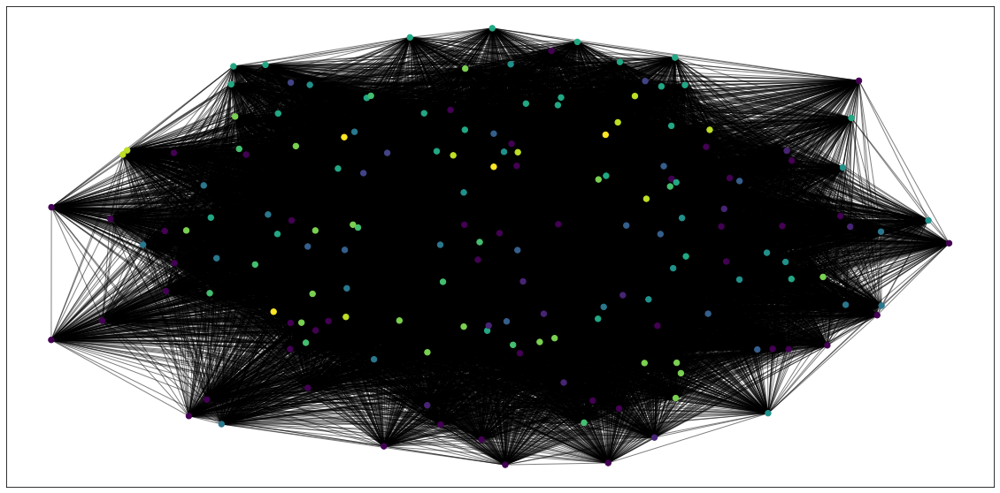

{0: [6, 7, 8, 28, 29, 43, 44, 45, 49, 53, 56, 60, 64, 81, 82, 105, 108, 121, 124, 138, 141, 146, 159, 160, 184, 186, 192, 201, 210, 221, 224, 229, 247, 248, 255, 279, 283, 288, 290, 300, 313, 402, 423, 524, 564, 581, 605, 799], 1: [47, 164, 165, 177, 281, 289, 330, 386, 394, 541], 2: [83, 114, 558, 592], 3: [99, 213, 257, 291, 354, 383, 396, 528, 583, 759, 826], 4: [106, 116, 161, 176, 178, 188, 207, 265, 306, 370, 594, 646, 760], 5: [109, 167, 169, 174, 181, 226, 259, 260, 271, 329, 380, 419, 584], 6: [110, 111, 153, 180, 182, 190, 222, 228, 261, 286, 294, 299, 312, 316, 320, 335, 338, 349, 366, 367, 373, 376, 388, 392, 397, 400, 408, 426, 818], 7: [118, 148, 242, 243, 292, 311, 341, 363, 410, 424, 428]}
=============/co_matrix_en_end.csv=============
Object for COMMUNITY DETECTION


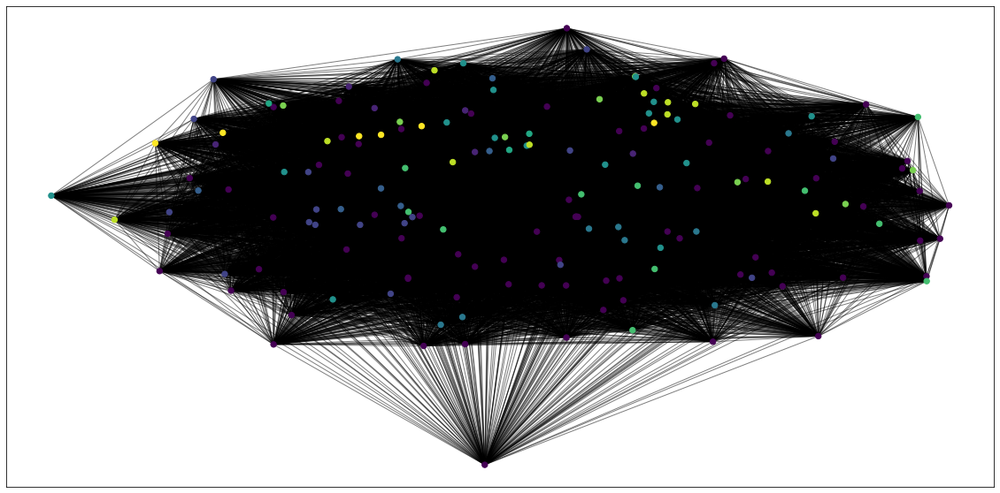

{0: [6, 7, 8, 28, 29, 43, 44, 45, 47, 49, 53, 56, 60, 64, 81, 82, 105, 108, 110, 111, 118, 121, 124, 129, 138, 141, 146, 148, 153, 160, 165, 167, 174, 176, 177, 178, 180, 181, 182, 184, 186, 190, 191, 201, 207, 208, 210, 222, 224, 226, 228, 242, 247, 256, 257, 267, 290, 299, 309, 312, 335, 350, 363, 370, 386, 389, 392, 394, 396, 397, 424, 524, 558, 564, 568, 584, 799, 809], 1: [283, 325, 341, 354, 402, 592], 2: [83, 147, 188, 221, 248, 271, 292, 303, 315, 318, 330, 348, 410, 419, 514, 541, 583], 3: [99, 265, 306, 311, 320, 359, 818], 4: [106, 116, 159, 192, 260, 301, 380, 428, 581], 5: [109, 185, 258, 279, 288, 291, 338, 353, 367, 382, 383, 400, 590, 605, 733, 760], 6: [114, 528, 646], 7: [161, 213, 233, 238, 243, 245, 255, 261, 268, 313, 316]}
=============/co_matrix_bf_end.csv=============
Object for COMMUNITY DETECTION


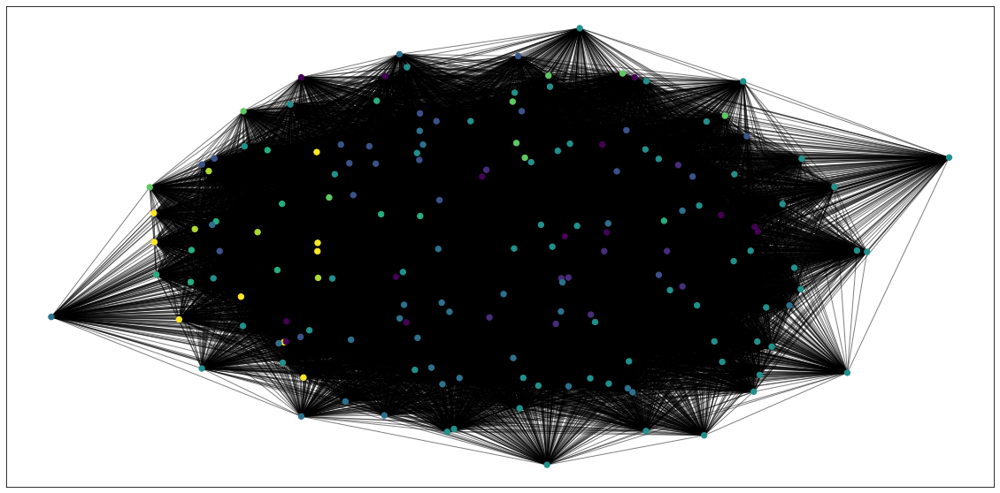

{0: [116, 169, 181, 184, 188, 213, 243, 268, 312, 389, 392, 423, 564, 584], 1: [109, 118, 161, 221, 267, 279, 300, 301, 366, 403], 2: [164, 167, 238, 245, 248, 257, 259, 292, 299, 306, 313, 335, 341, 360, 376, 386, 402, 426, 733, 760], 3: [83, 148, 182, 226, 232, 247, 258, 265, 271, 281, 283, 290, 291, 329, 353, 359, 363, 370, 380, 382, 394, 400, 410, 558, 568, 581, 646, 762, 809], 4: [6, 7, 8, 28, 29, 43, 44, 45, 47, 49, 53, 56, 60, 64, 81, 82, 99, 105, 106, 108, 110, 111, 121, 124, 129, 138, 141, 146, 153, 159, 160, 165, 174, 176, 177, 178, 185, 186, 190, 191, 192, 201, 207, 208, 210, 222, 228, 229, 242, 255, 256, 261, 289, 309, 311, 315, 318, 349, 373, 396, 541, 592, 826], 5: [114, 233, 330, 338, 350, 397, 419, 424, 514, 583, 799], 6: [260, 286, 288, 294, 303, 348, 408, 594, 605], 7: [320, 354, 528, 818]}
=============/co_matrix_af_end.csv=============
Object for COMMUNITY DETECTION


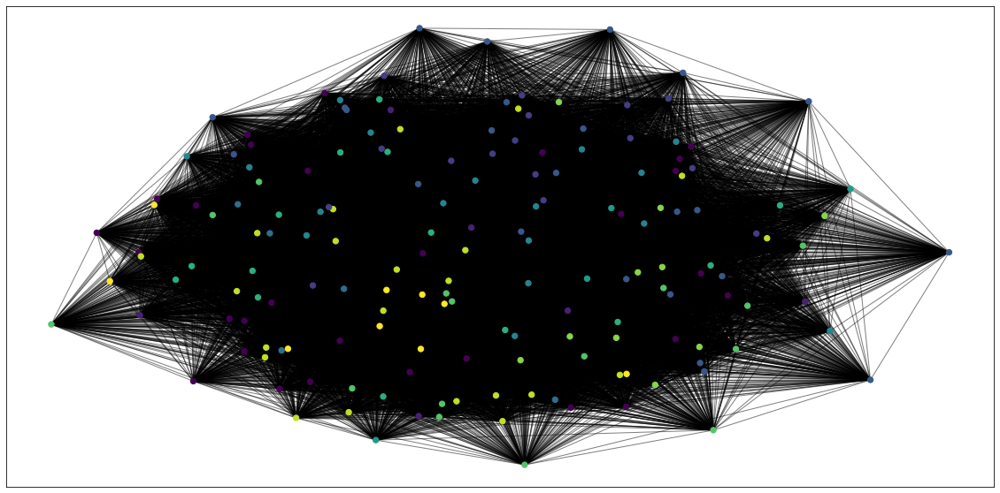

{0: [6, 28, 29, 44, 49, 60, 64, 81, 121, 124, 129, 138, 167, 169, 174, 201, 221, 224, 229, 271, 288, 313, 329, 380, 423, 541, 594, 760, 799], 1: [7, 8, 43, 108, 208, 402], 2: [182, 190, 228, 261, 286, 299, 316, 320, 338, 367, 373, 388, 392, 400, 426, 818], 3: [45, 53, 82, 106, 116, 159, 161, 178, 180, 184, 186, 188, 192, 207, 255, 265, 294, 306, 349, 370, 408, 524, 581, 646], 4: [47, 146, 177, 330, 394], 5: [56, 99, 160, 213, 257, 283, 291, 335, 354, 383, 396, 528, 564, 583, 592, 759, 826], 6: [83, 114, 141, 558], 7: [105, 153, 191, 222, 242, 248, 300, 318, 366, 397, 410, 428, 590, 733]}


In [80]:
for path in path_list:
    print(f'============={path}=============')
    detector = community_detection.community_detection()
    save_path = case_path+path
    G, node_and_edge_list = detector.fit(save_path)
    detector.make_plot(G, save_path)
    node_per_class = detector.node_per_class()
    save_pkl(node_and_edge_list, case_path+'/node_and_edge_list/'+path[-10:-4]+ '.pkl')
    save_pkl(node_per_class, case_path+'/node_per_class/'+path[-10:-4]+ '.pkl')